In [203]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import shapefile
import os

from tqdm.notebook import tqdm

from scipy import spatial

from skimage.filters import threshold_otsu
from skimage.morphology import remove_small_objects, remove_small_holes

from skimage.measure import regionprops_table, regionprops, label
import cv2

# mask2polygon
from skimage import measure
from shapely.geometry import Polygon

import easyidp as idp

In [2]:
# the file paths

## 2020
bbox20 = r"Z:\hwang_Pro\data\2020_tanashi_broccoli\12_locate_by_yolo\keep_bbox.shp"
pts20 = r"Z:\hwang_Pro\data\2020_tanashi_broccoli\10_locate_by_cv\color_label_0417_mavic\keep_points_manual.shp"

dom20 = [
    # bbox yolo from dom
    r"Z:\hwang_Pro\data\2020_tanashi_broccoli\01_tanashi_broccoli2020_RGB_AP\broccoli_tanashi_5_20200417_mavicRGB_15m_M\broccoli_tanashi_5_20200417_mavicRGB_15m_M_transparent_mosaic_group1.tif",
    # other seeding stage
]

## 2021
bbox21 = r"E:\2021_tanashi_broccoli\12_locate_by_yolo\keep_bbox.shp"
pts21 = r"E:\2021_tanashi_broccoli\12_locate_by_yolo\sorted_id.shp"

dom21 = [
    # bbox yolo from dom
    r"E:\2021_tanashi_broccoli\01_pix4d_projects\broccoli_tanashi_5_20210412_P4RTK_15m_M\3_dsm_ortho\2_mosaic\broccoli_tanashi_5_20210412_P4RTK_15m_M_transparent_mosaic_group1.tif",
    # other seeding stage
]

## 2022
bbox22 = r"E:\2022_tanashi_broccoli\10_root_position\shapefiles\keep_bbox.shp"
pts22 = r"E:\2022_tanashi_broccoli\10_root_position\shapefiles\ordered_center_points.shp"

dom22 = [
    # bbox yolo from dom
    r"E:\2022_tanashi_broccoli\01_metashape_projects\outputs\broccoli_tanashi_5_20211101_0\broccoli_tanashi_5_20211101_0_dom.tif", 
    # other seeding stage
]

# Read & calc bbox for 2022 test

In [5]:
# bbox info
bbox22_pd = pd.DataFrame(columns=["x0", "y0", "x1", "y1", "xc", "yc", "short", "long", "coord"])

bbox22_shp = shapefile.Reader(bbox22)
for shape in bbox22_shp.shapes():
    coord_geo = np.asarray(shape.points)

    size = np.max(coord_geo, axis=0) - np.min(coord_geo, axis=0)

    x0, y0 = np.min(coord_geo, axis=0)
    x1, y1 = np.max(coord_geo, axis=0)

    xc = np.mean([x0, x1])
    yc = np.mean([y0, y1])

    long_axis = max(size) * 100 # unit=cm
    short_axis = min(size) * 100

    bbox22_pd.loc[len(bbox22_pd)] = [x0, y0, x1, y1, xc, yc, short_axis, long_axis, coord_geo]

In [6]:
bbox22_pd

,x0,y0,x1,y1,xc,yc,short,long,coord
0,368059.740057,3.956063e+06,368059.841957,3.956063e+06,368059.791007,3.956063e+06,10.190012,13.043215,"[[368059.740056749, 3956063.443203111], [36805..."
1,368056.393657,3.956062e+06,368056.536317,3.956062e+06,368056.464987,3.956062e+06,4.891206,14.266017,"[[368056.39365683735, 3956062.2896937625], [36..."
2,368057.954767,3.956062e+06,368058.028135,3.956062e+06,368057.991451,3.956062e+06,6.521608,7.336809,"[[368057.95476666215, 3956062.2448577103], [36..."
3,368057.563470,3.956062e+06,368057.632762,3.956062e+06,368057.598116,3.956062e+06,6.929208,9.782411,"[[368057.56347020477, 3956062.460885963], [368..."
4,368060.143581,3.956062e+06,368060.261785,3.956062e+06,368060.202683,3.956062e+06,11.820414,18.342021,"[[368060.1435812207, 3956062.3304538103], [368..."
...,...,...,...,...,...,...,...,...,...
12045,368129.822883,3.956020e+06,368130.104127,3.956020e+06,368129.963505,3.956020e+06,20.380024,28.124433,"[[368129.8228826704, 3956020.257932631], [3681..."
12046,368131.518501,3.956020e+06,368131.750833,3.956020e+06,368131.634667,3.956020e+06,23.233227,33.015639,"[[368131.51850065246, 3956020.0704364115], [36..."
12047,368130.271243,3.956021e+06,368130.462815,3.956021e+06,368130.367029,3.956021e+06,19.157222,21.602825,"[[368130.27124319447, 3956021.4399740123], [36..."
12048,368130.715528,3.956022e+06,368130.915252,3.956022e+06,368130.815390,3.956022e+06,19.972423,28.124433,"[[368130.7155277138, 3956021.9576266175], [368..."


## build tree to search bbox

In [7]:
kdt = spatial.KDTree(bbox22_pd[["xc", "yc"]])

In [8]:
distance,index = kdt.query([368059.70337271, 3956057.88353261])
distance, index

(0.002038000151518628, 19)

## find bbox of each manual labeled points

In [9]:
pts22_shp = shapefile.Reader(pts22)

traits22_pd = pd.DataFrame(columns=["id", "bbox_short(cm)", "bbox_long(cm)"])

# get points
pbar = tqdm(pts22_shp.shapes())
for i, p in enumerate(pbar):
    coord_geo = np.asarray(p.points)
    dist, idx = kdt.query(coord_geo)

    broccoli_id = pts22_shp.records()[i][0]

    if dist < 0.01:  # in the bbox
        out = bbox22_pd[["short", "long"]].iloc[idx].values[0,:].tolist()
    else:
        out = [-1000.0, -1000.0]

    traits22_pd.loc[len(traits22_pd)] = [broccoli_id] + out

  0%|          | 0/11098 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [10]:
traits22_pd

,id,bbox_short(cm),bbox_long(cm)
0,1,14.266017,21.195225
1,4,16.304019,17.934421
2,6,15.488818,19.564823
3,959,5.706407,12.228014
4,139,17.119220,17.119220
...,...,...,...
64,293,12.228014,15.896419
65,563,14.266017,22.010426
66,958,8.152010,13.858416
67,423,22.010426,26.901631


In [11]:
traits22_pd[["bbox_short(cm)"]].values

array([[14.26601666],
       [16.30401906],
       [15.48881811],
       [ 5.70640666],
       [17.11922001],
       [ 9.78241144],
       [12.22801427],
       [15.89641855],
       [12.63561477],
       [16.30401906],
       [10.19001193],
       [17.52682049],
       [14.67361715],
       [11.41281334],
       [15.89641858],
       [15.89641859],
       [ 5.70640667],
       [15.08121763],
       [13.04321522],
       [17.11921999],
       [14.26601668],
       [13.45081571],
       [11.41281334],
       [16.71161954],
       [16.71161954],
       [15.08121761],
       [17.11921999],
       [10.59761243],
       [13.04321525],
       [20.38002382],
       [ 7.74440905],
       [17.52682049],
       [12.22801432],
       [11.00521287],
       [15.89641858],
       [18.74962193],
       [17.11921999],
       [17.52682049],
       [15.08121765],
       [15.89641855],
       [14.26601668],
       [13.85841621],
       [13.45081571],
       [16.30401909],
       [15.4888181 ],
       [19

**Above is simple output 1**

---

## crop bbox and segment green parts

In [12]:
dom = idp.GeoTiff(dom22[0])

In [13]:
pts22_shp = shapefile.Reader(pts22)

traits22_pd = pd.DataFrame(columns=["id", "bbox_short(cm)", "bbox_long(cm)"])

# get points
pbar = tqdm(pts22_shp.shapes())
for i, p in enumerate(pbar):
    coord_geo = np.asarray(p.points)
    dist, idx = kdt.query(coord_geo)

    broccoli_id = pts22_shp.records()[i][0]

    if dist < 0.01:  # in the bbox
        out = bbox22_pd[["short", "long"]].iloc[idx].values[0,:].tolist()
        bbox_poly = bbox22_pd.coord.iloc[idx]
        bbox_rgb = dom.crop_polygon(bbox_poly.values[0], is_geo=True)

    else:
        out = [-1000.0, -1000.0]

    traits22_pd.loc[len(traits22_pd)] = [broccoli_id] + out
    break

  0%|          | 0/11098 [00:00<?, ?it/s]

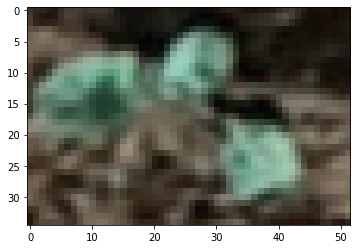

In [14]:
plt.imshow(bbox_rgb)

**calculate the green index**

In [77]:
R = bbox_rgb[:, :, 0]
G = bbox_rgb[:, :, 1]
B = bbox_rgb[:, :, 2]

exg = 2 * G - R - B
exr = 1.4 * R - G

ex_gr = exg - exr

binary_gr1 = ex_gr > 0

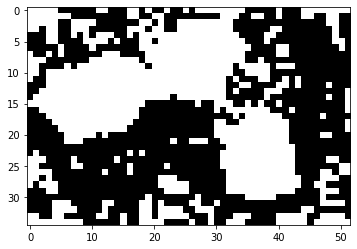

In [16]:
plt.imshow(binary_gr1, cmap="gray")

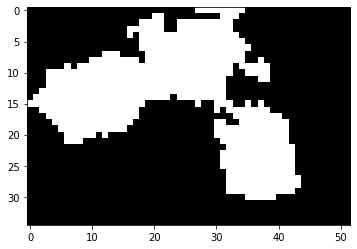

In [17]:
keep_binary = remove_small_objects(binary_gr1)
holefill_binary = remove_small_holes(keep_binary)
plt.imshow(holefill_binary, cmap="gray")

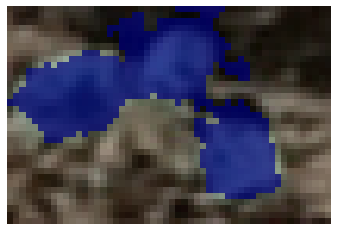

In [18]:
fig, ax = plt.subplots(1,1)
ax.imshow(bbox_rgb)
masked1 = np.ma.masked_where(holefill_binary == 0, holefill_binary)
ax.imshow(masked1, cmap="jet", interpolation='none', alpha=0.7)

plt.axis('off')

plt.show()

**calculate traits**

In [55]:
# utils/mask2polygon.py modified
def mask2polygon(mask):
    # mask = remove_small_holes(mask==255, area_threshold=100)
    # mask = remove_small_objects(mask, min_size=100, connectivity=1)
    
    h, _ = mask.shape
    contours = measure.find_contours(mask)
    contour = np.vstack(contours)
    simplified = []
    # for contour in contours:
    # temp = np.array(contour, dtype=np.int32)
    # coords = np.unique(temp, axis=0)
    contour = np.flip(contour, axis=1)
    contour[:, 1] = h - contour[:, 1]
    polygon = Polygon(contour)
    result = np.array(polygon.simplify(0.7).exterior.coords)
    result[:, 1] = h - result[: ,1]
    simplified.append(result)
        
    return simplified

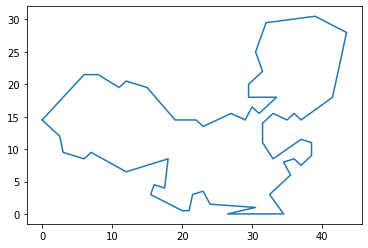

In [56]:
pix = mask2polygon(holefill_binary)

for p in pix:
    p = np.asarray(p)
    plt.plot(p[:,0], p[:,1])

In [57]:
rect = cv2.minAreaRect(pix[0].astype(np.int32))
label_img = label(masked1)

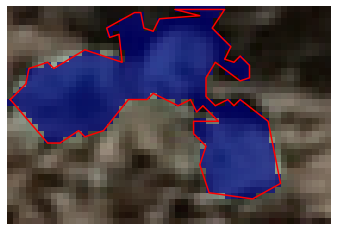

In [61]:
fig, ax = plt.subplots(1,1)
ax.imshow(bbox_rgb)
masked1 = np.ma.masked_where(holefill_binary == 0, holefill_binary)
ax.imshow(masked1, cmap="jet", interpolation='none', alpha=0.7)
plt.plot(*pix[0].T, color='r')

plt.axis('off')

plt.show()

In [64]:
props = pd.DataFrame(regionprops_table(label_img, properties=["area", "convex_area", "eccentricity", "equivalent_diameter", "major_axis_length", "minor_axis_length", "perimeter"]))
props['circularity'] = 4 * props.area * np.pi / props.perimeter ** 2
props['label'] = broccoli_id

props["min_area_rect_max"] = max(rect[1][0], rect[1][1])
props["min_area_rect_min"] = min(rect[1][0], rect[1][1])
props = props[["label", "area", "convex_area", "eccentricity", "equivalent_diameter", "major_axis_length", "minor_axis_length", "min_area_rect_max", "min_area_rect_min", "perimeter", 'circularity']]
props

,label,area,convex_area,eccentricity,equivalent_diameter,major_axis_length,minor_axis_length,min_area_rect_max,min_area_rect_min,perimeter,circularity
0,1,570,904,0.816883,26.939683,46.845106,27.020424,45.215706,28.305767,185.509668,0.208138


In [95]:
np.unique(label_img)

array([0, 1])

In [65]:
dom.header.keys()

dict_keys(['height', 'width', 'dim', 'nodata', 'dtype', 'tags', 'photometric', 'planarconfig', 'compress', 'scale', 'tie_point', 'crs'])

In [69]:
scale = dom.header['scale'][0] * 100 # per pixel size in cm
scale

0.40760047645328773

In [70]:
props["area"] = props.area * scale ** 2
props["convex_area"] = props.convex_area * scale ** 2
props['equivalent_diameter'] = props.equivalent_diameter * scale
props["major_axis_length"] = props.major_axis_length * scale
props["minor_axis_length"] = props.minor_axis_length * scale
props["min_area_rect_max"] = props.min_area_rect_max * scale
props["min_area_rect_min"] = props.min_area_rect_min * scale
props["perimeter"] = props.perimeter * scale
props

,label,area,convex_area,eccentricity,equivalent_diameter,major_axis_length,minor_axis_length,min_area_rect_max,min_area_rect_min,perimeter,circularity
0,1,94.698745,150.188886,0.816883,10.980628,19.094087,11.013538,18.429943,11.537444,75.613829,0.208138


# Batch processing

DOM prepared
Read bbox info
bbox info prepared
Read points info


  0%|          | 0/11098 [00:00<?, ?it/s]

Broccoli [327] segmentation failed
Broccoli [1361] segmentation failed
Broccoli [1777] segmentation failed
Broccoli [1240] segmentation failed
Broccoli [602] segmentation failed
Broccoli [138] segmentation failed
Broccoli [1563] segmentation failed
Broccoli [1973] segmentation failed
can not find bbox for id [1859]
can not find bbox for id [1961]
Broccoli [526] segmentation failed
Broccoli [941] segmentation failed
Broccoli [1212] segmentation failed
Broccoli [792] segmentation failed
Broccoli [523] segmentation failed
Broccoli [2371] segmentation failed
Broccoli [3203] segmentation failed
can not find bbox for id [2794]
Broccoli [2004] segmentation failed
Broccoli [4677] segmentation failed
can not find bbox for id [4007]
Broccoli [5089] segmentation failed
can not find bbox for id [4705]
Broccoli [6882] segmentation failed
Broccoli [6336] segmentation failed
Broccoli [6200] segmentation failed
Broccoli [6343] segmentation failed
Broccoli [5661] segmentation failed
Broccoli [5670] seg

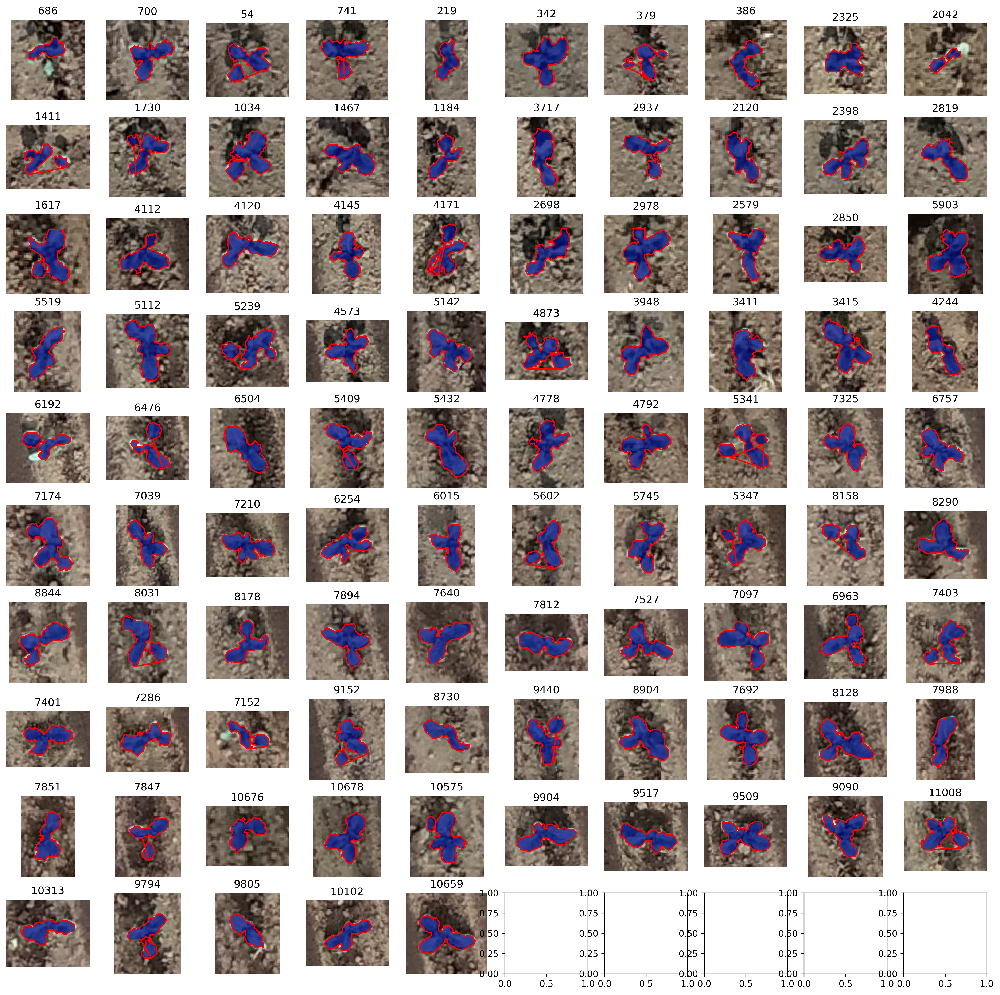

Total ['327', '1361', '1777', '1240', '602', '138', '1563', '1973', '526', '941', '1212', '792', '523', '2371', '3203', '2004', '4677', '5089', '6882', '6336', '6200', '6343', '5661', '5670', '5195', '5467', '6411', '6145', '5879', '6173', '5619', '7481', '7616', '7495', '7497', '8389', '10293', '8552', '10470', '10215', '9941'] broccoli segmentation failed


In [168]:
# def one_year(bbox, pts, dom):

bbox = bbox22
pts = pts22
dom = dom22

print("DOM prepared")
dom = idp.GeoTiff(dom[0])

#################
# get bbox info
#################
print("Read bbox info")
# bbox info
bbox_pd = pd.DataFrame(columns=["x0", "y0", "x1", "y1", "xc", "yc", "short", "long", "coord"])

bbox_shp = shapefile.Reader(bbox)

pbar = tqdm(bbox_shp.shapes())
for shape in pbar:
    coord_geo = np.asarray(shape.points)

    size = np.max(coord_geo, axis=0) - np.min(coord_geo, axis=0)

    x0, y0 = np.min(coord_geo, axis=0)
    x1, y1 = np.max(coord_geo, axis=0)

    xc = np.mean([x0, x1])
    yc = np.mean([y0, y1])

    long_axis = max(size) * 100 # unit=cm
    short_axis = min(size) * 100

    bbox_pd.loc[len(bbox_pd)] = [x0, y0, x1, y1, xc, yc, short_axis, long_axis, coord_geo]

kdt = spatial.KDTree(bbox_pd[["xc", "yc"]])

print("bbox info prepared")

#################
# get points info
#################
print("Read points info")
pts_shp = shapefile.Reader(pts)

traits_pd = pd.DataFrame(columns=[
    "id", "status", "bbox_short(cm)", "bbox_long(cm)", "area(cm2)", "convex_area(cm2)", "eccentricity", 
    "equivalent_diameter(cm)", "major_axis_length(cm)", "minor_axis_length(cm)", 
    "min_area_rect_max(cm)", "min_area_rect_min(cm)", "perimeter", 'circularity'
])

mean_half = bbox_pd.long.mean() / 200  # unit to m

# choose random index to plots results
random_indices = np.random.choice(len(bbox_pd), size=100, replace=False)
# random_indices = np.linspace(0,99,100).astype(np.int32)
fig_pos = 0
fig, ax = plt.subplots(10, 10, figsize=(20, 20), dpi=300)

failed_id = []

# get points
pbar = tqdm(pts_shp.shapes())
for i, p in enumerate(pbar):
    coord_geo = np.asarray(p.points)
    dist, idx = kdt.query(coord_geo)

    broccoli_id = int(pts_shp.records()[i][0])

    if dist < 0.01:  # in the bbox
        out = bbox_pd[["short", "long"]].iloc[idx].values[0,:].tolist()
        bbox_poly = bbox_pd.coord.iloc[idx]
        bbox_np = bbox_poly.values[0]
    else:
        print(f"can not find bbox for id [{i}]")
        out = [0.0, 0.0]   # means no bbox

        # use mean bbox size to get new for missing one
        xc, yc = coord_geo[0]
        bbox_np = np.array([
            [xc - mean_half, yc - mean_half],
            [xc - mean_half, yc + mean_half],
            [xc + mean_half, yc + mean_half],
            [xc + mean_half, yc - mean_half],
            [xc - mean_half, yc - mean_half],
        ])

    p = Polygon(bbox_np)
    p_buffer = p.buffer(mean_half*0.5, cap_style=3)
    poly = np.array(p_buffer.exterior.coords)
    bbox_rgb = dom.crop_polygon(poly, is_geo=True)

    ################
    # bbox segment #
    ################

    R = bbox_rgb[:, :, 0]
    G = bbox_rgb[:, :, 1]
    B = bbox_rgb[:, :, 2]

    exg = 2 * G - R - B
    exr = 1.4 * R - G
    ex_gr = exg - exr
    binary_gr1 = (ex_gr > 0) & (ex_gr < 130)

    keep_binary = remove_small_objects(binary_gr1)
    holefill_binary = remove_small_holes(keep_binary)

    if (holefill_binary == 1).sum() < 20:
        traits_pd.loc[len(traits_pd)] = [broccoli_id, "failed", 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
        failed_id.append(broccoli_id)
        print(f"Broccoli [{broccoli_id}] segmentation failed")
        continue

    masked1 = np.ma.masked_where(holefill_binary == 0, holefill_binary)

    poly4cv = mask2polygon(holefill_binary)
    rect = cv2.minAreaRect(poly4cv[0].astype(np.int32))

    label_img = holefill_binary.astype(np.int8)

    props = pd.DataFrame(regionprops_table(label_img, properties=["area", "convex_area", "eccentricity", "equivalent_diameter", "major_axis_length", "minor_axis_length", "perimeter"]))
    props['circularity'] = 4 * props.area * np.pi / props.perimeter ** 2
    props['id'] = broccoli_id

    props["min_area_rect_max"] = max(rect[1][0], rect[1][1])
    props["min_area_rect_min"] = min(rect[1][0], rect[1][1])
    props = props[["id", "area", "convex_area", "eccentricity", "equivalent_diameter", "major_axis_length", "minor_axis_length", "min_area_rect_max", "min_area_rect_min", "perimeter", 'circularity']]

    if len(props) != 1:
        print(f"len(props) = {len(props)}")
        break

    traits_pd.loc[len(traits_pd)] = [
        broccoli_id, 
        "success",
        out[0], out[1],  # "bbox_short(cm)", "bbox_long(cm)"
        props.area.values[0] * scale ** 2, 
        props.convex_area.values[0] * scale ** 2,  
        props.eccentricity.values[0],
        props.equivalent_diameter.values[0] * scale,
        props.major_axis_length.values[0] * scale,
        props.minor_axis_length.values[0] * scale,
        props.min_area_rect_max.values[0] * scale,
        props.min_area_rect_min.values[0] * scale,
        props.perimeter.values[0] * scale,
        props.circularity.values[0]
    ]

    # draw figures
    if i in random_indices:
        ri = fig_pos // 10
        ci = fig_pos % 10

        ax[ri, ci].imshow(bbox_rgb[:,:,0:3])
        ax[ri, ci].imshow(masked1, cmap="jet", interpolation='none', alpha=0.7)
        ax[ri, ci].plot(*poly4cv[0].T, color='r')
        ax[ri, ci].axis('off')
        ax[ri, ci].set_title(broccoli_id)

        fig_pos += 1

    #return traits_pd
plt.savefig(r"E:\hwang_jupyter\06_broccoli.paper\03_data_ana\out\2022_rand100.png")
plt.show()

print(f"Total {failed_id} broccoli segmentation failed")

traits_pd.to_excel(r"E:\hwang_jupyter\06_broccoli.paper\03_data_ana\out\bbox_traits2022.xlsx", index=False)

In [173]:
traits_pd = traits_pd.sort_values(by=['id'])
traits_pd

,id,status,bbox_short(cm),bbox_long(cm),area(cm2),convex_area(cm2),eccentricity,equivalent_diameter(cm),major_axis_length(cm),minor_axis_length(cm),min_area_rect_max(cm),min_area_rect_min(cm),perimeter,circularity
0,1,success,14.266017,21.195225,89.050048,142.380393,0.844212,10.648100,19.385289,10.390684,18.696122,10.869839,65.266982,0.262698
42,2,success,13.450816,13.450816,54.825589,73.433062,0.905030,8.355005,13.940458,5.929540,14.445559,7.028187,47.781128,0.301773
20,3,success,14.266017,16.711619,84.564318,132.578242,0.832684,10.376446,18.182132,10.068330,17.329716,10.997704,63.383330,0.264513
1,4,success,16.304019,17.934421,103.171790,172.949812,0.727015,11.461344,18.282462,12.553139,17.982913,13.273102,83.809290,0.184581
47,5,success,16.711620,18.342021,126.264993,178.598510,0.828252,12.679337,19.506522,10.930604,19.715233,12.063202,77.806181,0.262099
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11051,11094,success,15.488818,19.564823,57.982214,106.660691,0.874027,8.592162,18.094473,8.791695,16.979784,9.418812,56.832755,0.225583
11062,11095,success,17.526820,18.342021,83.401350,130.916861,0.806924,10.304848,16.893042,9.977953,14.884281,11.687977,60.122526,0.289940
11071,11096,success,15.896419,17.526820,88.551633,130.086170,0.889336,10.618260,18.159216,8.303372,16.770576,9.165112,60.995661,0.299095
11048,11097,success,16.711620,17.119220,57.982214,105.165448,0.910059,8.592162,18.769070,7.779371,14.482477,9.853628,50.605364,0.284519


In [174]:
traits_pd.to_excel(r"E:\hwang_jupyter\06_broccoli.paper\03_data_ana\out\bbox_traits2022.xlsx", index=False)

In [166]:
coord_geo

array([[ 368071.47307523, 3956019.47656494]])

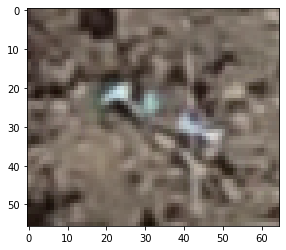

In [160]:
plt.imshow(bbox_rgb[:,:,0:3])

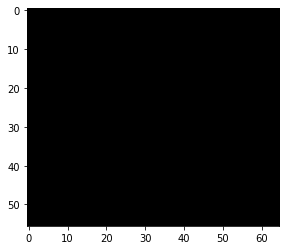

In [161]:
plt.imshow(holefill_binary, cmap="gray")

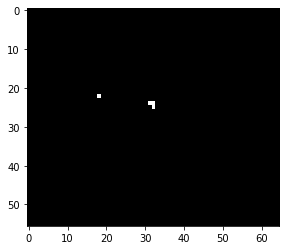

In [162]:
plt.imshow(binary_gr1, cmap="gray")

In [163]:
(holefill_binary == 1).sum() 

0

In [154]:
np.linspace(0,99,100).astype(np.int32)

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
       85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99])

In [169]:
random_indices

array([ 6101,  9082,  7772,  7214,  1116,  7065,  7357,  2771,  6477,
        9946,  8477,  5458,   135,  1905,  1199,  7448,  5613,  9701,
       10667,  1952,  8369, 11625,  4175,  4397, 10863,  2646,  8735,
       10023,  9891,  2164, 10309,  2684,   307,  4304,  1209,  4320,
        4571,  3097,  9202,  7082,  5293, 11384,  4099,  4449, 10323,
        7844,  4024,  6329,  8089,  3166, 11234,    34,   851,  8992,
        7513,  7137,  5070,  6277,  1831,  5086,  9108,  6911,  3223,
        5005,   933,  2853,  1494,  8150,  6310,  5073,  7781,  7704,
        9497,  3997, 11910,  9109,  5657, 10720,  3957,  5249,  5995,
        7382,  9116,  3381,  6298, 11001,  7903,  7233, 11740,  1086,
        6091,  1822,  4691,  7261,  9179,  6742,  8479,  7776,   821,
        3529])

In [170]:
len(random_indices)

100

# 2021

DOM prepared
Read bbox info
bbox info prepared
Read points info


  0%|          | 0/3620 [00:00<?, ?it/s]

can not find bbox for id [3] with distance=[0.18225648] (find closest bbox=[2])
can not find bbox for id [1262] with distance=[0.10638666] (find closest bbox=[86])
can not find bbox for id [160] with distance=[0.11367726] (find closest bbox=[210])
can not find bbox for id [1165] with distance=[0.11699062] (find closest bbox=[470])
can not find bbox for id [2798] with distance=[0.30104316] (find closest bbox=[1921])
can not find bbox for id [2246] with distance=[0.17350482] (find closest bbox=[823])
can not find bbox for id [2249] with distance=[0.22313174] (find closest bbox=[920])
can not find bbox for id [2255] with distance=[0.12515248] (find closest bbox=[940])
can not find bbox for id [1977] with distance=[0.10054701] (find closest bbox=[988])
can not find bbox for id [1155] with distance=[0.12920763] (find closest bbox=[1073])
can not find bbox for id [2145] with distance=[0.11028918] (find closest bbox=[1156])
can not find bbox for id [793] with distance=[0.23942282] (find close

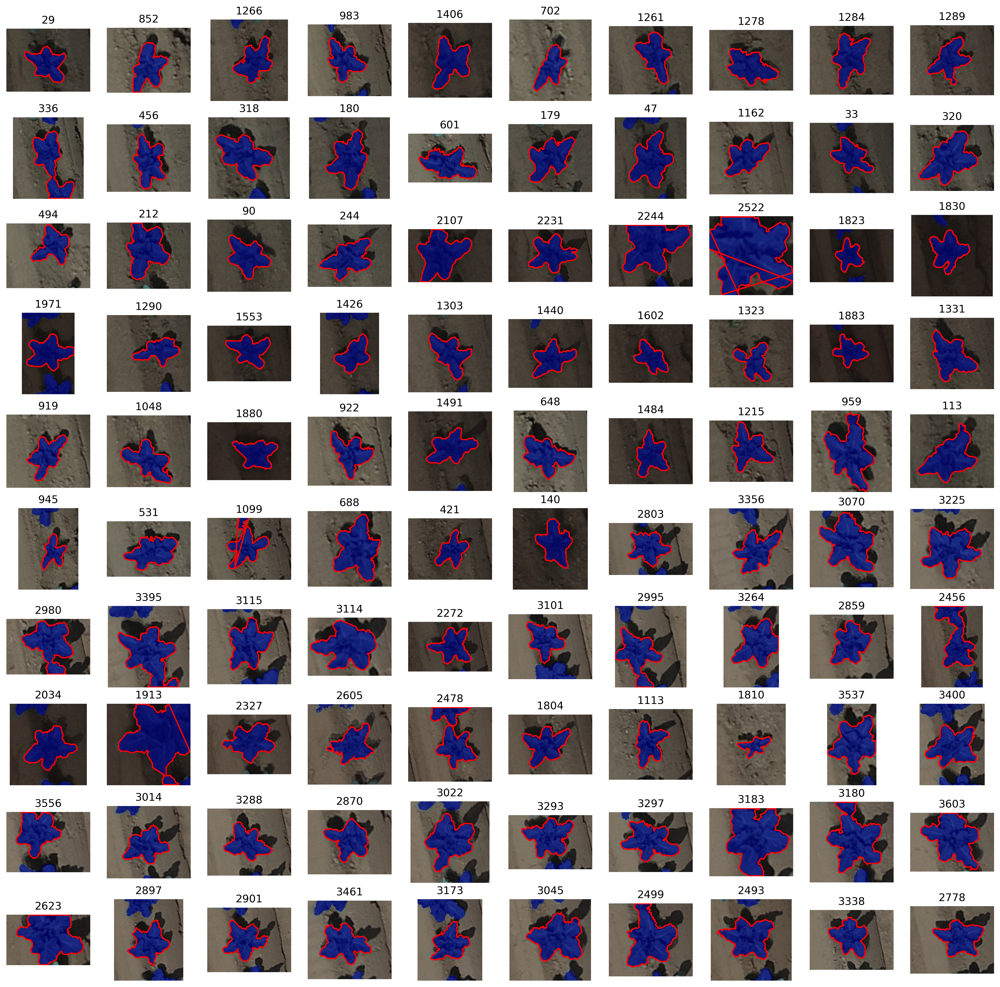

Total [] broccoli segmentation failed


In [255]:
# def one_year(bbox, pts, dom):

bbox = bbox21
pts = pts21
dom = dom21

print("DOM prepared")
dom = idp.GeoTiff(dom[0])

#################
# get bbox info
#################
print("Read bbox info")
# bbox info
# bbox_pd = pd.DataFrame(columns=["id", "x0", "y0", "x1", "y1", "xc", "yc", "short", "long", "coord"])

# bbox_shp = shapefile.Reader(bbox)

# pbar = tqdm(bbox_shp.shapes())
# for i, shape in enumerate(pbar):
#     coord_geo = np.asarray(shape.points)

#     idx = int(bbox_shp.records()[i][0])

#     size = np.max(coord_geo, axis=0) - np.min(coord_geo, axis=0)

#     x0, y0 = np.min(coord_geo, axis=0)
#     x1, y1 = np.max(coord_geo, axis=0)

#     xc = np.mean([x0, x1])
#     yc = np.mean([y0, y1])

#     long_axis = max(size) * 100 # unit=cm
#     short_axis = min(size) * 100

#     bbox_pd.loc[len(bbox_pd)] = [idx, x0, y0, x1, y1, xc, yc, short_axis, long_axis, coord_geo]

# kdt = spatial.KDTree(bbox_pd[["xc", "yc"]])

print("bbox info prepared")

#################
# get points info
#################
print("Read points info")
pts_shp = shapefile.Reader(pts)

traits_pd = pd.DataFrame(columns=[
    "id", "status", "bbox_short(cm)", "bbox_long(cm)", "area(cm2)", "convex_area(cm2)", "eccentricity", 
    "equivalent_diameter(cm)", "major_axis_length(cm)", "minor_axis_length(cm)", 
    "min_area_rect_max(cm)", "min_area_rect_min(cm)", "perimeter", 'circularity'
])

mean_half = bbox_pd.long.mean() / 200  # unit to m

# choose random index to plots results
random_indices = np.random.choice(len(bbox_pd), size=100, replace=False)
# random_indices = np.linspace(0,99,100).astype(np.int32)
fig_pos = 0
fig, ax = plt.subplots(10, 10, figsize=(20, 20), dpi=300)

failed_id = []

# get points
pbar = tqdm(pts_shp.shapes())
for i, p in enumerate(pbar):
    coord_geo = np.asarray(p.points)
    dist, idx = kdt.query(coord_geo)

    broccoli_id = int(pts_shp.records()[i][0])

    if dist < 0.1:  # in the bbox
        out = bbox_pd[["short", "long"]].iloc[idx].values[0,:].tolist()
        bbox_poly = bbox_pd.coord.iloc[idx]
        bbox_np = bbox_poly.values[0]
    else:
        print(f"can not find bbox for id [{broccoli_id}] with distance={dist} (find closest bbox={bbox_pd['id'].iloc[idx].values})")
        out = [0.0, 0.0]   # means no bbox

        # use mean bbox size to get new for missing one
        xc, yc = coord_geo[0]
        bbox_np = np.array([
            [xc - mean_half, yc - mean_half],
            [xc - mean_half, yc + mean_half],
            [xc + mean_half, yc + mean_half],
            [xc + mean_half, yc - mean_half],
            [xc - mean_half, yc - mean_half],
        ])

    p = Polygon(bbox_np)
    p_buffer = p.buffer(mean_half*0.5, cap_style=3)
    poly = np.array(p_buffer.exterior.coords)
    bbox_rgb = dom.crop_polygon(poly, is_geo=True)

    ################
    # bbox segment #
    ################

    R = bbox_rgb[:, :, 0]
    G = bbox_rgb[:, :, 1]
    B = bbox_rgb[:, :, 2]

    exg = 2 * G - R - B
    exr = 1.4 * R - G
    ex_gr = exg - exr
    binary_gr1 = (ex_gr > 0) & (ex_gr < 130)

    keep_binary = remove_small_objects(binary_gr1)
    holefill_binary = remove_small_holes(keep_binary)

    if (holefill_binary == 1).sum() < 20:
        traits_pd.loc[len(traits_pd)] = [broccoli_id, "failed", 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
        failed_id.append(broccoli_id)
        print(f"Broccoli [{broccoli_id}] segmentation failed")
        continue

    # remove another broccoli touched the bbox edge
    label_img_temp = label(holefill_binary)
    if len(np.unique(label_img_temp)) > 2:
        h, w = holefill_binary.shape
        rm_candidate_id = []
        for region in regionprops(label_img_temp):
            # r = vertical, c = horizontal
            minr, minc, maxr, maxc = region.bbox
            bb = [minr, minc, maxr, maxc]

            r_center = (minr + maxr) / 2
            c_center = (minc + maxc) / 2

            # very far away from center
            if abs(r_center - 0.5*h) > 0.5*0.5*h or abs(c_center - 0.5*w) > 0.5*0.5*w:
                # and touch the edges or too small
                if w in bb or h in bb or 0 in bb or region.area < 0.05 * h * w:
                    rm_candidate_id.append(region.label)
                    label_img_temp[label_img_temp == region.label] = 0
            else:
                label_img_temp[label_img_temp == region.label] = 1

        label_img = label_img_temp
    else:
        label_img = holefill_binary.astype(np.int8)

    masked1 = np.ma.masked_where(holefill_binary == 0, holefill_binary)

    poly4cv = mask2polygon(label_img)
    rect = cv2.minAreaRect(poly4cv[0].astype(np.int32))

    props = pd.DataFrame(regionprops_table(label_img, properties=["area", "convex_area", "eccentricity", "equivalent_diameter", "major_axis_length", "minor_axis_length", "perimeter"]))
    props['circularity'] = 4 * props.area * np.pi / props.perimeter ** 2
    props['id'] = broccoli_id

    props["min_area_rect_max"] = max(rect[1][0], rect[1][1])
    props["min_area_rect_min"] = min(rect[1][0], rect[1][1])
    props = props[["id", "area", "convex_area", "eccentricity", "equivalent_diameter", "major_axis_length", "minor_axis_length", "min_area_rect_max", "min_area_rect_min", "perimeter", 'circularity']]

    if len(props) != 1:
        print(f"len(props) = {len(props)}")
        plt.imshow(label_img)
        plt.show()
        break

    traits_pd.loc[len(traits_pd)] = [
        broccoli_id, 
        "success",
        out[0], out[1],  # "bbox_short(cm)", "bbox_long(cm)"
        props.area.values[0] * scale ** 2, 
        props.convex_area.values[0] * scale ** 2,  
        props.eccentricity.values[0],
        props.equivalent_diameter.values[0] * scale,
        props.major_axis_length.values[0] * scale,
        props.minor_axis_length.values[0] * scale,
        props.min_area_rect_max.values[0] * scale,
        props.min_area_rect_min.values[0] * scale,
        props.perimeter.values[0] * scale,
        props.circularity.values[0]
    ]

    # draw figures
    if i in random_indices:
        ri = fig_pos // 10
        ci = fig_pos % 10

        ax[ri, ci].imshow(bbox_rgb[:,:,0:3])
        ax[ri, ci].imshow(masked1, cmap="jet", interpolation='none', alpha=0.7)
        ax[ri, ci].plot(*poly4cv[0].T, color='r')
        ax[ri, ci].axis('off')
        ax[ri, ci].set_title(broccoli_id)

        fig_pos += 1

    #return traits_pd
plt.savefig(r"E:\hwang_jupyter\06_broccoli.paper\03_data_ana\out\bbox_rand2021.png")
plt.show()

print(f"Total {failed_id} broccoli segmentation failed")

traits_pd = traits_pd.sort_values(by=['id'])
traits_pd.to_excel(r"E:\hwang_jupyter\06_broccoli.paper\03_data_ana\out\bbox_traits2021.xlsx", index=False)

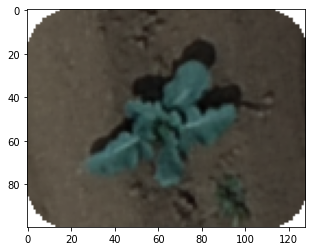

In [248]:
plt.imshow(bbox_rgb)

In [249]:
np.unique(label_img)

array([0, 1, 2])

##### Algorithms to keep the center polygon

In [254]:
h, w = holefill_binary.shape
rm_candidate_id = []
for region in regionprops(label_img):
    # r = vertical, c = horizontal
    minr, minc, maxr, maxc = region.bbox
    bb = [minr, minc, maxr, maxc]

    r_center = (minr + maxr) / 2
    c_center = (minc + maxc) / 2

    # very far away from center
    if abs(r_center - 0.5*h) > 0.5*0.5*h or abs(c_center - 0.5*w) > 0.5*0.5*w:
        # and touch the edges
        if w in bb or h in bb or 0 in bb or region.area < 0.05 * h * w:
            rm_candidate_id.append(region.label)

    print(h, w, bb)

rm_candidate_id

100 128 [22, 28, 82, 97]
100 128 [77, 87, 96, 99]


[2]

In [253]:
region.area, 0.01 * h * w

(145, 128.0)

# 2020

DOM prepared
Read bbox info


  0%|          | 0/7749 [00:00<?, ?it/s]

bbox info prepared
Read points info


  0%|          | 0/7537 [00:00<?, ?it/s]

can not find bbox for id [291] with distance=[0.37457449] (find closest bbox=[2256])
Broccoli [291] segmentation failed
can not find bbox for id [3361] with distance=[0.29555311] (find closest bbox=[2346])
can not find bbox for id [1710] with distance=[0.23791712] (find closest bbox=[2998])
can not find bbox for id [2316] with distance=[0.3824824] (find closest bbox=[3969])
can not find bbox for id [4833] with distance=[0.31687556] (find closest bbox=[4153])
can not find bbox for id [5122] with distance=[0.2827787] (find closest bbox=[4146])
can not find bbox for id [4547] with distance=[0.32219] (find closest bbox=[4135])
can not find bbox for id [5162] with distance=[0.3381099] (find closest bbox=[5210])
can not find bbox for id [4067] with distance=[0.10049766] (find closest bbox=[5500])
can not find bbox for id [5612] with distance=[0.30705718] (find closest bbox=[6187])
can not find bbox for id [7226] with distance=[0.1883181] (find closest bbox=[7348])


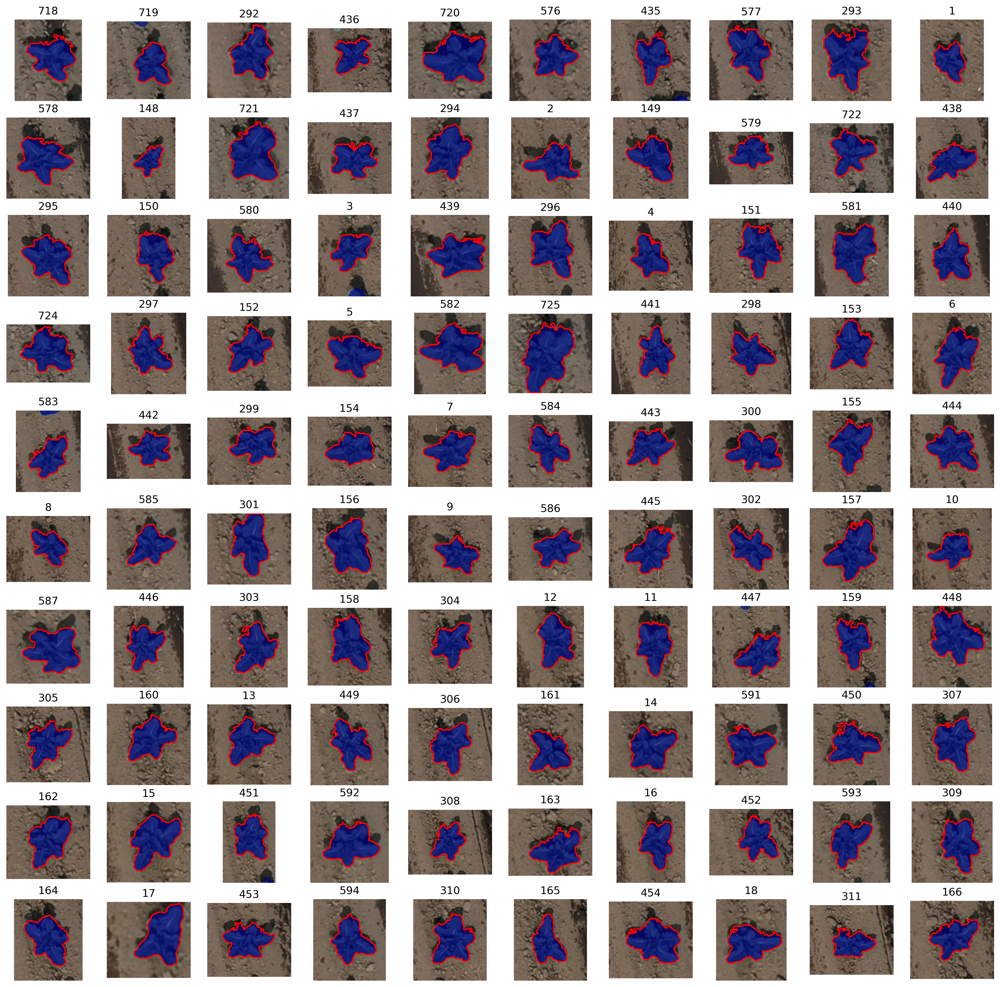

Total [291] broccoli segmentation failed


In [257]:
# def one_year(bbox, pts, dom):

bbox = bbox20
pts = pts20
dom = dom20

print("DOM prepared")
dom = idp.GeoTiff(dom[0])

#################
# get bbox info
#################
print("Read bbox info")
# bbox info
bbox_pd = pd.DataFrame(columns=["id", "x0", "y0", "x1", "y1", "xc", "yc", "short", "long", "coord"])

bbox_shp = shapefile.Reader(bbox)

pbar = tqdm(bbox_shp.shapes())
for i, shape in enumerate(pbar):
    coord_geo = np.asarray(shape.points)

    idx = int(bbox_shp.records()[i][0])

    size = np.max(coord_geo, axis=0) - np.min(coord_geo, axis=0)

    x0, y0 = np.min(coord_geo, axis=0)
    x1, y1 = np.max(coord_geo, axis=0)

    xc = np.mean([x0, x1])
    yc = np.mean([y0, y1])

    long_axis = max(size) * 100 # unit=cm
    short_axis = min(size) * 100

    bbox_pd.loc[len(bbox_pd)] = [idx, x0, y0, x1, y1, xc, yc, short_axis, long_axis, coord_geo]

kdt = spatial.KDTree(bbox_pd[["xc", "yc"]])

print("bbox info prepared")

#################
# get points info
#################
print("Read points info")
pts_shp = shapefile.Reader(pts)

traits_pd = pd.DataFrame(columns=[
    "id", "status", "bbox_short(cm)", "bbox_long(cm)", "area(cm2)", "convex_area(cm2)", "eccentricity", 
    "equivalent_diameter(cm)", "major_axis_length(cm)", "minor_axis_length(cm)", 
    "min_area_rect_max(cm)", "min_area_rect_min(cm)", "perimeter", 'circularity'
])

mean_half = bbox_pd.long.mean() / 200  # unit to m

# choose random index to plots results
random_indices = np.random.choice(len(bbox_pd), size=100, replace=False)
random_indices = np.linspace(0,99,100).astype(np.int32)
fig_pos = 0
fig, ax = plt.subplots(10, 10, figsize=(20, 20), dpi=300)

failed_id = []

# get points
pbar = tqdm(pts_shp.shapes())
for i, p in enumerate(pbar):
    coord_geo = np.asarray(p.points)
    dist, idx = kdt.query(coord_geo)

    broccoli_id = int(pts_shp.records()[i][0])

    if dist < 0.1:  # in the bbox
        out = bbox_pd[["short", "long"]].iloc[idx].values[0,:].tolist()
        bbox_poly = bbox_pd.coord.iloc[idx]
        bbox_np = bbox_poly.values[0]
    else:
        print(f"can not find bbox for id [{broccoli_id}] with distance={dist} (find closest bbox={bbox_pd['id'].iloc[idx].values})")
        out = [0.0, 0.0]   # means no bbox

        # use mean bbox size to get new for missing one
        xc, yc = coord_geo[0]
        bbox_np = np.array([
            [xc - mean_half, yc - mean_half],
            [xc - mean_half, yc + mean_half],
            [xc + mean_half, yc + mean_half],
            [xc + mean_half, yc - mean_half],
            [xc - mean_half, yc - mean_half],
        ])

    p = Polygon(bbox_np)
    p_buffer = p.buffer(mean_half*0.5, cap_style=3)
    poly = np.array(p_buffer.exterior.coords)
    bbox_rgb = dom.crop_polygon(poly, is_geo=True)

    ################
    # bbox segment #
    ################

    R = bbox_rgb[:, :, 0]
    G = bbox_rgb[:, :, 1]
    B = bbox_rgb[:, :, 2]

    exg = 2 * G - R - B
    exr = 1.4 * R - G
    ex_gr = exg - exr
    binary_gr1 = (ex_gr > 0) & (ex_gr < 130)

    keep_binary = remove_small_objects(binary_gr1)
    holefill_binary = remove_small_holes(keep_binary)

    if (holefill_binary == 1).sum() < 20:
        traits_pd.loc[len(traits_pd)] = [broccoli_id, "failed", 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
        failed_id.append(broccoli_id)
        print(f"Broccoli [{broccoli_id}] segmentation failed")
        continue

    # remove another broccoli touched the bbox edge
    label_img_temp = label(holefill_binary)
    if len(np.unique(label_img_temp)) > 2:
        h, w = holefill_binary.shape
        rm_candidate_id = []
        for region in regionprops(label_img_temp):
            # r = vertical, c = horizontal
            minr, minc, maxr, maxc = region.bbox
            bb = [minr, minc, maxr, maxc]

            r_center = (minr + maxr) / 2
            c_center = (minc + maxc) / 2

            # very far away from center
            if abs(r_center - 0.5*h) > 0.5*0.5*h or abs(c_center - 0.5*w) > 0.5*0.5*w:
                # and touch the edges or too small
                if w in bb or h in bb or 0 in bb or region.area < 0.05 * h * w:
                    rm_candidate_id.append(region.label)
                    label_img_temp[label_img_temp == region.label] = 0
            else:
                label_img_temp[label_img_temp == region.label] = 1

        label_img = label_img_temp
    else:
        label_img = holefill_binary.astype(np.int8)

    masked1 = np.ma.masked_where(holefill_binary == 0, holefill_binary)

    poly4cv = mask2polygon(label_img)
    rect = cv2.minAreaRect(poly4cv[0].astype(np.int32))

    props = pd.DataFrame(regionprops_table(label_img, properties=["area", "convex_area", "eccentricity", "equivalent_diameter", "major_axis_length", "minor_axis_length", "perimeter"]))
    props['circularity'] = 4 * props.area * np.pi / props.perimeter ** 2
    props['id'] = broccoli_id

    props["min_area_rect_max"] = max(rect[1][0], rect[1][1])
    props["min_area_rect_min"] = min(rect[1][0], rect[1][1])
    props = props[["id", "area", "convex_area", "eccentricity", "equivalent_diameter", "major_axis_length", "minor_axis_length", "min_area_rect_max", "min_area_rect_min", "perimeter", 'circularity']]

    if len(props) != 1:
        print(f"len(props) = {len(props)}")
        plt.imshow(label_img)
        plt.show()
        break

    traits_pd.loc[len(traits_pd)] = [
        broccoli_id, 
        "success",
        out[0], out[1],  # "bbox_short(cm)", "bbox_long(cm)"
        props.area.values[0] * scale ** 2, 
        props.convex_area.values[0] * scale ** 2,  
        props.eccentricity.values[0],
        props.equivalent_diameter.values[0] * scale,
        props.major_axis_length.values[0] * scale,
        props.minor_axis_length.values[0] * scale,
        props.min_area_rect_max.values[0] * scale,
        props.min_area_rect_min.values[0] * scale,
        props.perimeter.values[0] * scale,
        props.circularity.values[0]
    ]

    # draw figures
    if i in random_indices:
        ri = fig_pos // 10
        ci = fig_pos % 10

        ax[ri, ci].imshow(bbox_rgb[:,:,0:3])
        ax[ri, ci].imshow(masked1, cmap="jet", interpolation='none', alpha=0.7)
        ax[ri, ci].plot(*poly4cv[0].T, color='r')
        ax[ri, ci].axis('off')
        ax[ri, ci].set_title(broccoli_id)

        fig_pos += 1

    #return traits_pd
plt.savefig(r"E:\hwang_jupyter\06_broccoli.paper\03_data_ana\out\bbox_rand2020.png")
plt.show()

print(f"Total {failed_id} broccoli segmentation failed")

traits_pd = traits_pd.sort_values(by=['id'])
traits_pd.to_excel(r"E:\hwang_jupyter\06_broccoli.paper\03_data_ana\out\bbox_traits2020.xlsx", index=False)